<a href="https://colab.research.google.com/github/asmitamohanty/DROID/blob/main/DROID_100_behavior_cloning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DROID: A Large-Scale In-The-Wild Robot Manipulation Dataset

![](https://droid-dataset.github.io/droid/assets/index/droid_teaser.jpg)

This Colab demonstrates how to load and visualize samples from the DROID dataset. Please also check out our [dataset visualizer](https://droid-dataset.github.io/dataset.html) to explore the dataset.

You can download the full dataset (1.7TB) using:
```
gsutil -m cp -r gs://gresearch/robotics/droid <your_local_path>
```

If you'd like to download an example version of the dataset with 100 episodes first (2GB), run:
```
gsutil -m cp -r gs://gresearch/robotics/droid_100 <your_local_path>
```

If you want to use DROID for policy training, please check out our [policy training repo](https://github.com/droid-dataset/droid_policy_learning).

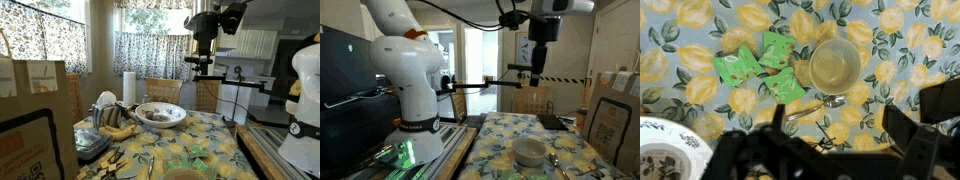

In [1]:
import tensorflow_datasets as tfds
import numpy as np
from PIL import Image
from IPython import display

def as_gif(images, path="temp.gif"):
  # Render the images as the gif (15Hz control frequency):
  images[0].save(path, save_all=True, append_images=images[1:], duration=int(1000/15), loop=0)
  gif_bytes = open(path,"rb").read()
  return gif_bytes


ds = tfds.load("droid_100", data_dir="gs://gresearch/robotics", split="train")

images = []
for episode in ds.shuffle(10, seed=0).take(1):
  #print(len(episode["steps"]))
  for i, step in enumerate(episode["steps"]):
    #print("Index:", i)
    images.append(
      Image.fromarray(
        np.concatenate((
              step["observation"]["exterior_image_1_left"].numpy(),
              step["observation"]["exterior_image_2_left"].numpy(),
              step["observation"]["wrist_image_left"].numpy(),
        ), axis=1)
      )
    )
    #print(step["action"])
    #plt.imshow(step["observation"]["exterior_image_1_left"].numpy())
    #plt.show()
    #if i==3:
      #break

display.Image(as_gif(images))

In [2]:
# Available Features (note that 'reward' is a dummy feature at the moment)
import tensorflow_datasets as tfds

builder = tfds.builder_from_directory(builder_dir="gs://gresearch/robotics/droid/1.0.0")
builder.info.features

FeaturesDict({
    'episode_metadata': FeaturesDict({
        'file_path': string,
        'recording_folderpath': string,
    }),
    'steps': Dataset({
        'action': Tensor(shape=(7,), dtype=float64, description=Robot action, consists of [6x joint velocities, 1x gripper position].),
        'action_dict': FeaturesDict({
            'cartesian_position': Tensor(shape=(6,), dtype=float64, description=Commanded Cartesian position),
            'cartesian_velocity': Tensor(shape=(6,), dtype=float64, description=Commanded Cartesian velocity),
            'gripper_position': Tensor(shape=(1,), dtype=float64, description=Commanded gripper position),
            'gripper_velocity': Tensor(shape=(1,), dtype=float64, description=Commanded gripper velocity),
            'joint_position': Tensor(shape=(7,), dtype=float64, description=Commanded joint position),
            'joint_velocity': Tensor(shape=(7,), dtype=float64, description=Commanded joint velocity),
        }),
        'discount'

## Raw DROID Data

The RLDS version of the DROID dataset is optimized for loading speed during policy training. Thus, it contains lower-resolution images (180x320 px) and no stereo or depth data. If you need access to the full-HD, stereo videos we recorded, you can download the raw DROID data with the following command:
```
gsutil -m cp -r gs://gresearch/robotics/droid_raw <your_local_path>
```
Here we store data in MP4 format for more efficient storage. For more information about the raw data format, see our [developer documentation](https://droid-dataset.github.io/droid/the-droid-dataset.html).

In [3]:
print(builder.info.features['steps']['observation']['exterior_image_1_left'])
print(builder.info.features['steps']['action'])

Image(shape=(180, 320, 3), dtype=uint8, description=Exterior camera 1 left viewpoint)
Tensor(shape=(7,), dtype=float64, description=Robot action, consists of [6x joint velocities, 1x gripper position].)


In [4]:
action_dim = builder.info.features['steps']['action'].shape[0]
print(action_dim)

7


In [5]:
import matplotlib.pyplot as plt

In [6]:
import torch
from torch import nn
from torch.utils.data import DataLoader, random_split, Dataset
from torchvision import transforms
import torch.nn.functional as F
import torch.optim as optim

In [7]:
!pip install torchinfo

In [8]:
from torchinfo import summary

In [9]:
for episode in ds.take(1):
  print(len(episode["steps"]))
  for i, step in enumerate(episode["steps"]):
    action = step['action']
    action_dict = step['action_dict']
    print(action)
    print("Action shape:", action.shape)
    print(action_dict.keys())
    #plt.bar(range(len(action.numpy())), action.numpy())
    #plt.show()
    break

166
tf.Tensor(
[ 0.38357484  0.07346953  0.55135942 -2.89342165 -0.19871207  0.12699035
  0.        ], shape=(7,), dtype=float64)
Action shape: (7,)
dict_keys(['cartesian_position', 'cartesian_velocity', 'gripper_position', 'gripper_velocity', 'joint_position', 'joint_velocity'])


In [10]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [11]:
dataset_list = list(tfds.as_numpy(ds))
print(dataset_list)

[{'episode_metadata': {'file_path': b'/nfs/kun2/datasets/r2d2/r2d2-data-full/RAIL/success/2023-04-17/Mon_Apr_17_14:48:05_2023/trajectory.h5', 'recording_folderpath': b'/nfs/kun2/datasets/r2d2/r2d2-data-full/RAIL/success/2023-04-17/Mon_Apr_17_14:48:05_2023/recordings/MP4'}, 'steps': <tensorflow_datasets.core.dataset_utils._IterableDataset object at 0x7acee0f87590>}, {'episode_metadata': {'file_path': b'/nfs/kun2/datasets/r2d2/r2d2-data-full/RPL/success/2023-06-05/Mon_Jun__5_20:15:38_2023/trajectory.h5', 'recording_folderpath': b'/nfs/kun2/datasets/r2d2/r2d2-data-full/RPL/success/2023-06-05/Mon_Jun__5_20:15:38_2023/recordings/MP4'}, 'steps': <tensorflow_datasets.core.dataset_utils._IterableDataset object at 0x7ace1c359710>}, {'episode_metadata': {'file_path': b'/nfs/kun2/datasets/r2d2/r2d2-data-full/TRI/success/2023-10-18/Wed_Oct_18_15:39:19_2023/trajectory.h5', 'recording_folderpath': b'/nfs/kun2/datasets/r2d2/r2d2-data-full/TRI/success/2023-10-18/Wed_Oct_18_15:39:19_2023/recordings/MP4

In [12]:
print("Total length of droid dataset:", len(dataset_list))
print(dataset_list[0].keys())
print(dataset_list[0]['steps'])

Total length of droid dataset: 100
dict_keys(['episode_metadata', 'steps'])


In [13]:
exterior_imgs = []
for data in dataset_list[:5]:
  print(len(data['steps']))
  #print(len(data['steps']['action']))
  for e, episode in enumerate(data['steps']):
    #print("Index:",e)
    #print(episode['action'].shape)
    #print(episode['observation']['exterior_image_1_left'].shape)
    image = episode['observation']['exterior_image_1_left']
    #plt.imshow(image)
    #plt.show()
    if e==3:
      break


166
238
142
205
213


In [14]:
class custom_droid_dataset(Dataset):
  def __init__(self, tfds_dslist, num_samples = None, transform=None):
    self.data = tfds_dslist
    self.transform = transform

    self.images = []
    self.actions = []

    if num_samples is not None:
       self.data = self.data[:num_samples]

    for episode in self.data:
      for step in episode['steps']:
        image = step['observation']['exterior_image_1_left']
        action = step['action']
        self.images.append(torch.tensor(image, dtype=torch.uint8).permute(2,0,1))
        self.actions.append(torch.tensor(action, dtype=torch.float32))

  def __getitem__(self, index):
    image = self.images[index]
    action = self.actions[index]
    image = transforms.ToPILImage()(image)

    if self.transform:
      image = self.transform(image)

    return image, action

  def __len__(self):
    return len(self.images)

In [15]:
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    #transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

num_samples = 5
droid_dataset = custom_droid_dataset(dataset_list, num_samples, transform=transform)

# Load into DataLoader
dataloader = DataLoader(droid_dataset, batch_size=32, shuffle=True)

In [16]:
test_droid_dataset = custom_droid_dataset(dataset_list[5:6], num_samples=1, transform=transform)
testloader = DataLoader(test_droid_dataset, batch_size=32, shuffle=True)

In [17]:
print("Number of training batches of images:", len(dataloader))
print("Number of training samples:", len(dataloader.dataset))

Number of training batches of images: 31
Number of training samples: 964


In [18]:
print("Number of testing batches:", len(testloader))
print("Number of testing samples:", len(testloader.dataset))

Number of testing batches: 3
Number of testing samples: 87


Batch: torch.Size([32, 3, 256, 256]) torch.Size([32, 7])


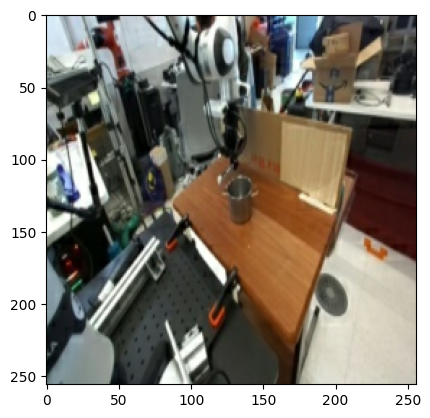

In [19]:
# Iterate through DataLoader
for batch in dataloader:
    imgs, actions = batch
    print("Batch:", imgs.shape, actions.shape)  # Output: (batch_size, C, H, W), (batch_size,)
    plt.imshow(imgs[0].permute(1,2,0).numpy())
    plt.show()
    break

Test Batch: torch.Size([32, 3, 256, 256]) torch.Size([32, 7])


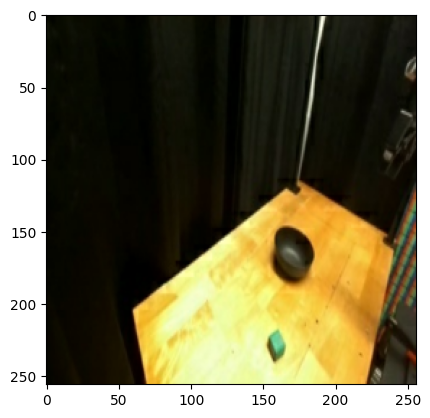

In [46]:
# Iterate through DataLoader
for batch in testloader:
    imgs, actions = batch
    print("Test Batch:", imgs.shape, actions.shape)  # Output: (batch_size, C, H, W), (batch_size,)
    plt.imshow(imgs[0].permute(1,2,0).numpy())
    plt.show()
    break

In [20]:
class droidmodel(nn.Module):
  def __init__(self, action_dim):
      super(droidmodel, self).__init__()

      self.cnn = nn.Sequential(
        nn.Conv2d(3, 32, kernel_size=3, padding=1), #ofm = 256
        nn.ReLU(),
        nn.MaxPool2d(kernel_size=2),
        nn.Conv2d(32, 64, kernel_size=3, padding=1), #128
        nn.ReLU(),
        nn.MaxPool2d(kernel_size=2),
        nn.Conv2d(64, 128, kernel_size=3, padding=1), #64
        nn.ReLU(),
        nn.MaxPool2d(kernel_size=2)        #32
      )

      self.mlp = nn.Sequential(
        nn.Linear(128 * 32 * 32, 128),
        nn.ReLU(),
        nn.Linear(128, 64),
        nn.ReLU(),
        nn.Linear(64, action_dim)
      )

  def forward(self, x):
      x = self.cnn(x)
      x = torch.flatten(x, start_dim=1)
      x = self.mlp(x)
      return x

In [21]:
droid = droidmodel(action_dim).to(device)
print(droid)

droidmodel(
  (cnn): Sequential(
    (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU()
    (8): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (mlp): Sequential(
    (0): Linear(in_features=131072, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=64, bias=True)
    (3): ReLU()
    (4): Linear(in_features=64, out_features=7, bias=True)
  )
)


In [26]:
print(summary(droid))

Layer (type:depth-idx)                   Param #
droidmodel                               --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       896
│    └─ReLU: 2-2                         --
│    └─MaxPool2d: 2-3                    --
│    └─Conv2d: 2-4                       18,496
│    └─ReLU: 2-5                         --
│    └─MaxPool2d: 2-6                    --
│    └─Conv2d: 2-7                       73,856
│    └─ReLU: 2-8                         --
│    └─MaxPool2d: 2-9                    --
├─Sequential: 1-2                        --
│    └─Linear: 2-10                      16,777,344
│    └─ReLU: 2-11                        --
│    └─Linear: 2-12                      8,256
│    └─ReLU: 2-13                        --
│    └─Linear: 2-14                      455
Total params: 16,879,303
Trainable params: 16,879,303
Non-trainable params: 0


In [25]:
def train(model: nn.Module, dataloader: DataLoader, epoch_num: int):

    num_training_batches = len(dataloader)
    loss_fn = torch.nn.L1Loss()
    optimizer = torch.optim.SGD(model.parameters(), lr=0.001, momentum=0.9)

    model.train()
    for epoch in range(epoch_num):  # Loop over the dataset for multiple epochs
        running_loss = 0.0

        for i, (inputs, labels) in enumerate(dataloader, 0):
            inputs, labels = inputs.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(inputs)
            loss = loss_fn(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            #print(f"Epoch {epoch+1}, Batch {i+1}/{num_training_batches}: Loss = {loss.item():.4f}")

        avg_epoch_loss = running_loss / num_training_batches
        print(f"Epoch {epoch+1} Average Loss: {avg_epoch_loss:.4f}")

    print('Finished Training')

In [27]:
train(droid, dataloader, 5)

Epoch 1 Average Loss: 0.6935
Epoch 2 Average Loss: 0.6372
Epoch 3 Average Loss: 0.6133
Epoch 4 Average Loss: 0.6087
Epoch 5 Average Loss: 0.5992
Finished Training


In [51]:
def test(model: nn.Module, dataloader: DataLoader):
    num_testing_batches = len(dataloader)
    total_test_loss = 0.0
    loss_fn = torch.nn.L1Loss()
    all_actions = []
    model.eval()
    with torch.no_grad():
        for batch, (inputs, labels) in enumerate(dataloader, 0):
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = loss_fn(outputs, labels)
            #print(outputs.shape)
            #print(f"Batch {batch}/{num_testing_batches}: shape: {outputs[0].shape}") #first action output: {outputs[0]},
            #print(f"Batch {batch}/{num_testing_batches}: shape: {labels[0].shape}") #first action label: {labels[0]},
            #print(f"Test Loss: {loss.item():.4f}")
            all_actions.append(outputs.cpu())
            total_test_loss += loss.item()
        avg_test_loss = total_test_loss / num_testing_batches
    all_actions = torch.cat(all_actions, dim=0)
    print(f"Average Test Loss: {avg_test_loss:.4f}")
    return all_actions

In [52]:
droid_action = test(droid, testloader)

Average Test Loss: 0.5562


In [53]:
print("Droid action shape:", droid_action.shape)

Droid action shape: torch.Size([87, 7])


In [54]:
print("Predicted action:", droid_action[0])

Predicted action: tensor([ 0.3485,  0.0556,  0.2295, -0.2102,  0.0761, -0.1212,  0.1338])
